# GAN
Build a GAN for anime face generation.

In [ ]:
workspace_dir = '.'
!pip install -q qqdm

In [ ]:
!gdown --id 1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p --output "{workspace_dir}/crypko_data.zip"

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p
To: /content/crypko_data.zip
100% 452M/452M [00:01<00:00, 233MB/s]


In [ ]:
!unzip -q "{workspace_dir}/crypko_data.zip" -d "{workspace_dir}/"

## Import

In [ ]:
import os
import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch import optim
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from qqdm.notebook import qqdm

## Dataset
1.Resize to (64, 64)
2.Liearly map the value from [0, 1] to [-1, 1]

In [ ]:
class CrypkoDataset(Dataset):
  def __init__(self, fnames, transform):
    self.transform = transform
    self.fnames = fnames
    self.num_samples = len(self.fnames)

  def __getitem__(self, idx):
    fname = self.fnames[idx]
    # load the image
    img = torchvision.io.read_image(fname)
    # resize and normalize
    img = self.transform(img)
    return img

  def __len__(self):
    return self.num_samples

def get_dataset(root):
  fnames = glob.glob(os.path.join(root, "*"))
  compose = [
             transforms.ToPILImage(),
             transforms.Resize((64, 64)),
             transforms.ToTensor(),
             transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
  ]
  transform = transforms.Compose(compose)
  dataset = CrypkoDataset(fnames, transform)
  return dataset

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


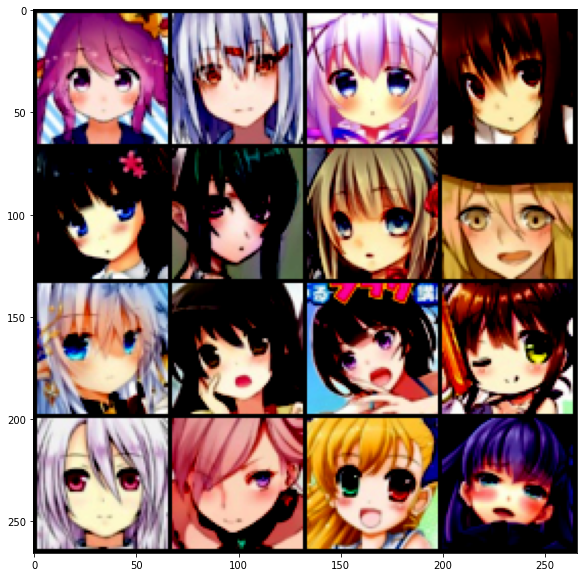

In [ ]:
dataset = get_dataset(os.path.join(workspace_dir, 'faces'))

images = [dataset[i] for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

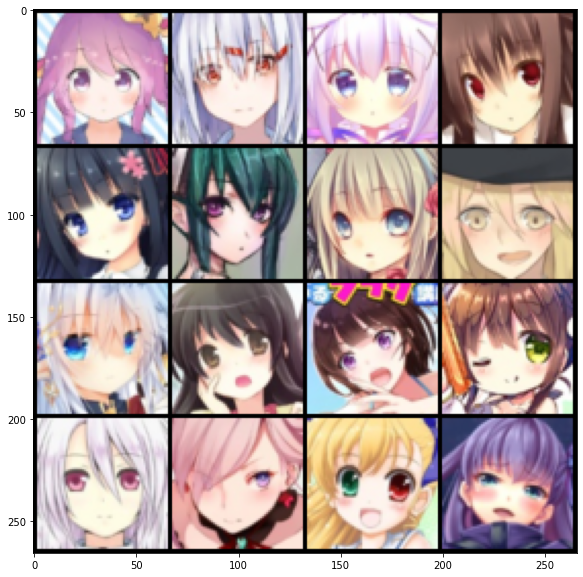

In [ ]:
# img -> +1 -> /2 : denormalize
images = [(dataset[i]+1)/2 for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10, 10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

## Model
Use DCGAN as the model structure.  
The `N` of the input/output shapes stands for the batch size.

In [ ]:
def weight_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    m.weight.data.normal_(0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    m.weight.data.normal_(1.0, 0.02)
    m.bias.data.fill_(0)

class Generator(nn.Module):
  """
  input shape: (N, in_dim)
  output shape: (N, 3, 64, 64)
  """
  def __init__(self, in_dim, dim=64):
    super(Generator, self).__init__()
    def dconv_bn_relu(in_dim, out_dim):
      return nn.Sequential(
          nn.ConvTranspose2d(in_dim, out_dim, 5, 2, padding=2, output_padding=1, bias=False),
          nn.BatchNorm2d(out_dim),
          nn.ReLU()
      )
    
    self.l1 = nn.Sequential(
        nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
        nn.BatchNorm1d(dim * 8 * 4 * 4),
        nn.ReLU()
    )

    self.l2_5 = nn.Sequential(
        dconv_bn_relu(dim * 8, dim * 4),
        dconv_bn_relu(dim * 4, dim * 2),
        dconv_bn_relu(dim * 2, dim),
        nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
        nn.Tanh()
    )
    self.apply(weight_init)

  def forward(self, x):
    y = self.l1(x)
    y = y.view(y.size(0), -1, 4, 4)
    y = self.l2_5(y)
    return y


class Discriminator(nn.Module):
  """
  input shape: (N, 3, 64, 64)
  output shape: (N, )
  """
  def __init__(self, in_dim, dim=64):
    super(Discriminator, self).__init__()

    def conv_bn_lrelu(in_dim, out_dim):
      return nn.Sequential(
          nn.Conv2d(in_dim, out_dim, 5, 2, 2),
          nn.BatchNorm2d(out_dim),
          nn.LeakyReLU()
      )
    # Remove the last sigmoid layer for WGAN
    self.ls = nn.Sequential(
        nn.Conv2d(in_dim, dim, 5, 2 ,2),
        nn.LeakyReLU(),
        conv_bn_lrelu(dim, dim * 2),
        conv_bn_lrelu(dim * 2, dim * 4),
        conv_bn_lrelu(dim * 4, dim * 8),
        nn.Conv2d(dim * 8, 1, 4),
        # nn.Sigmoid()
    )
    self.apply(weight_init)

  def forward(self, x):
    y = self.ls(x)
    y = y.view(-1)
    return y

## Training

In [ ]:
batch_size = 64
z_dim = 100
z_sample = Variable(torch.randn(100, z_dim)).cuda()
lr = 1e-4

# WGAN: 50 epoch, n_critic=5, clip_value=0.01
n_epoch = 50
n_critic = 5
clip_value = 0.01

log_dir = os.path.join(workspace_dir, 'logs')
ckpt_dir = os.path.join(workspace_dir, 'checkpoints')
os.makedirs(log_dir, exist_ok=True)
os.makedirs(ckpt_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss
criterion = nn.BCELoss()

# Use RMSprop for WGAN
opt_D = optim.RMSprop(D.parameters(), lr)
opt_G = optim.RMSprop(G.parameters(), lr)

# DataLoader
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

## Training Loop
Store some pictures regularly to monitor the current performance of the Generator, and regularly record checkpoint.

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:39<00:00:00  3.28it/s  -1.4997  0.7581    1    1115           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_001.jpg.


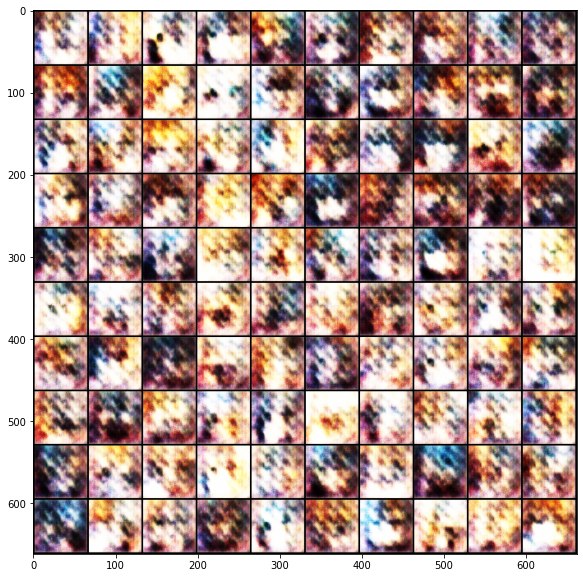

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:41<00:00:00  3.27it/s  -1.5326  0.7753    2    2230           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_002.jpg.


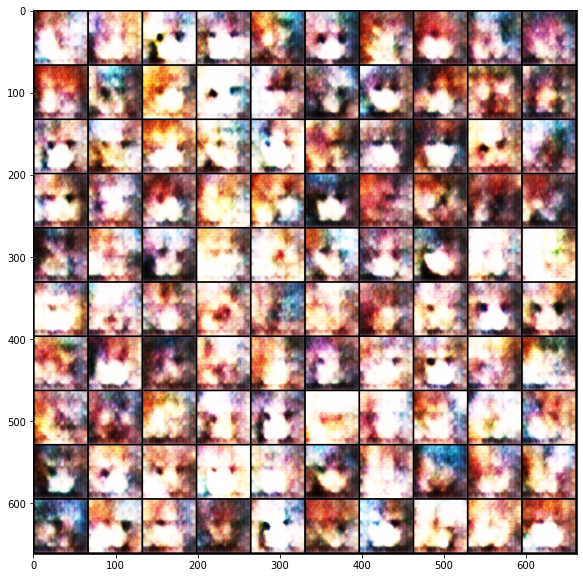

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:40<00:00:00  3.27it/s  -1.5034  0.7653    3    3345           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_003.jpg.


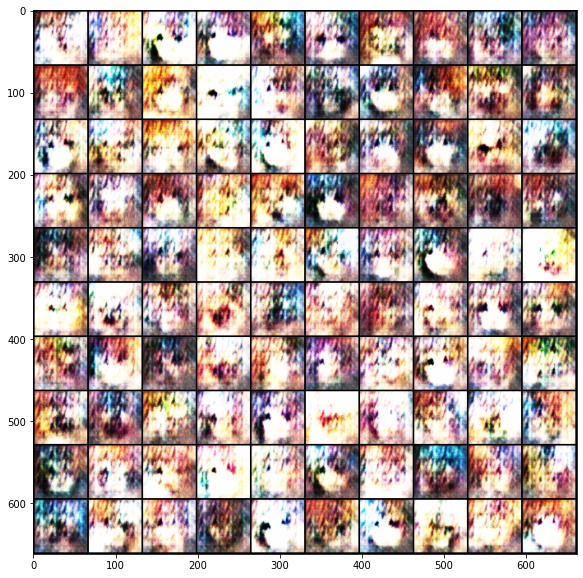

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:41<00:00:00  3.27it/s  -1.5096  0.7629    4    4460           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_004.jpg.


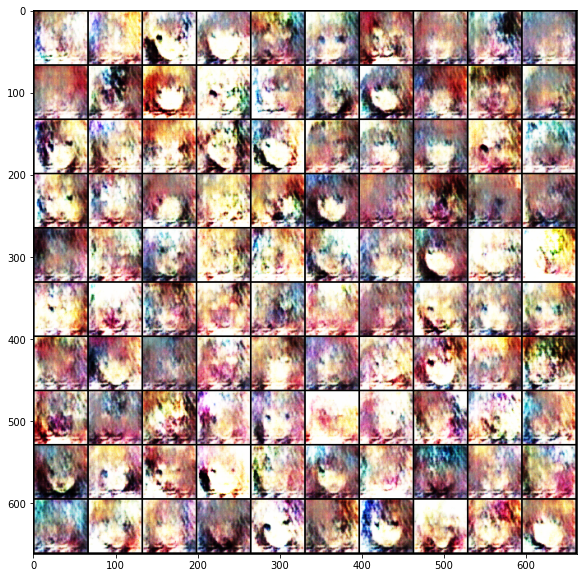

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:41<00:00:00  3.27it/s  -1.4956  0.7601    5    5575           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_005.jpg.


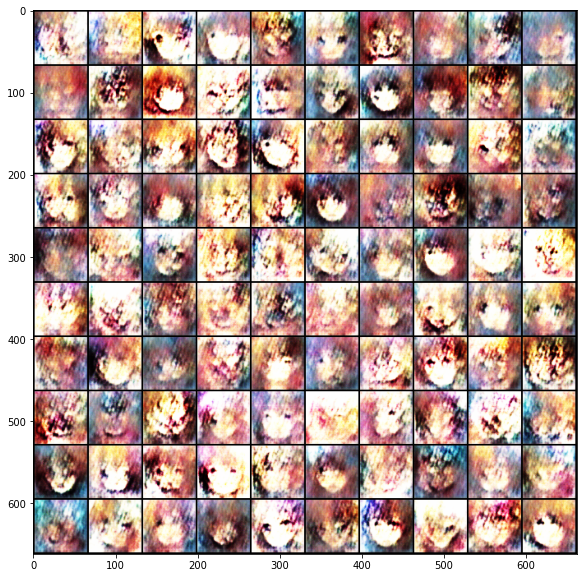

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:41<00:00:00  3.26it/s  -1.5304  0.7718    6    6690           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_006.jpg.


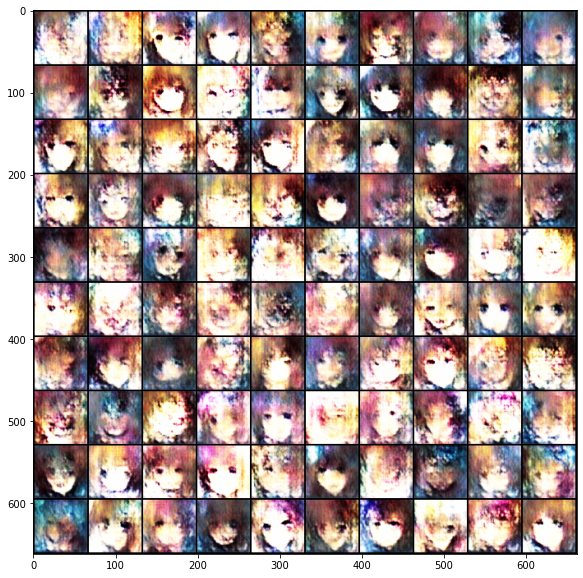

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:43<00:00:00  3.24it/s  -1.5293  0.7734    7    7805           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_007.jpg.


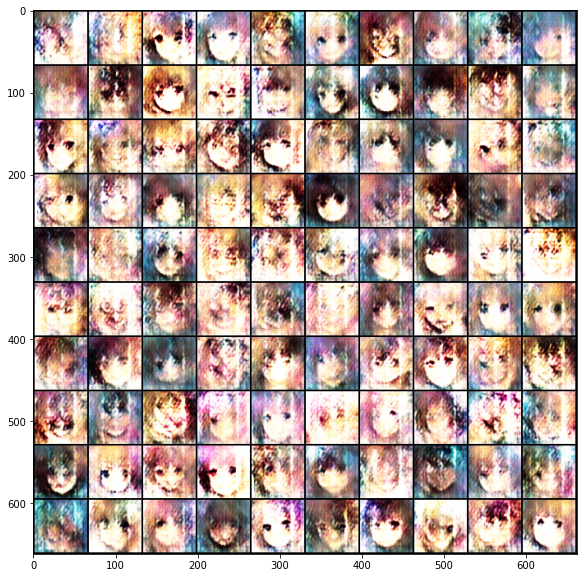

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4964  0.7451    8    8920           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_008.jpg.


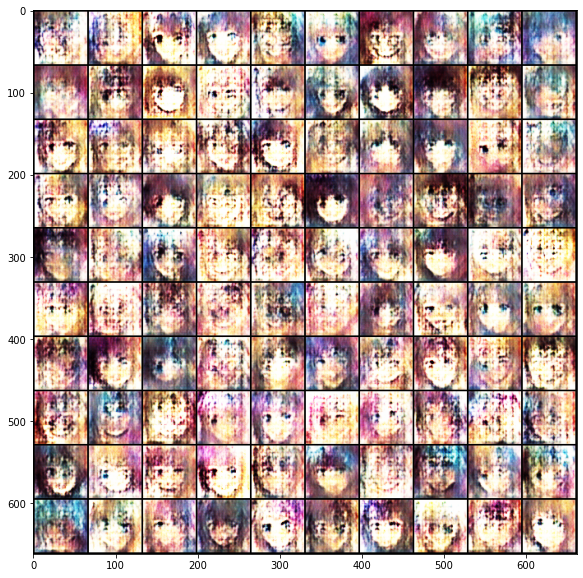

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4916  0.7597    9    10035          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_009.jpg.


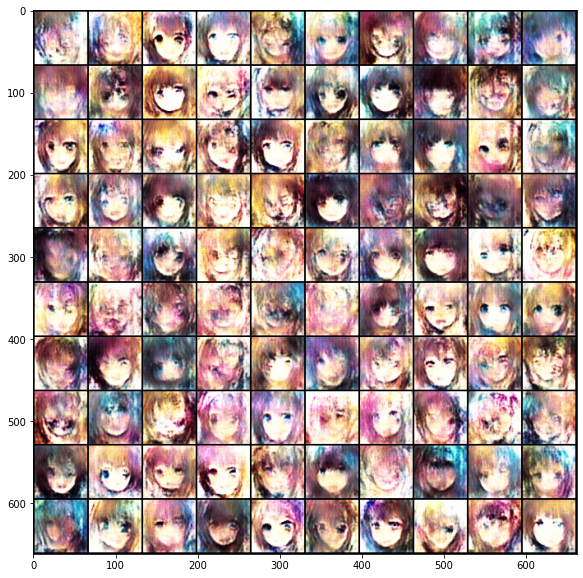

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:47<00:00:00  3.21it/s  -0.3441  0.6516   10    11150          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_010.jpg.


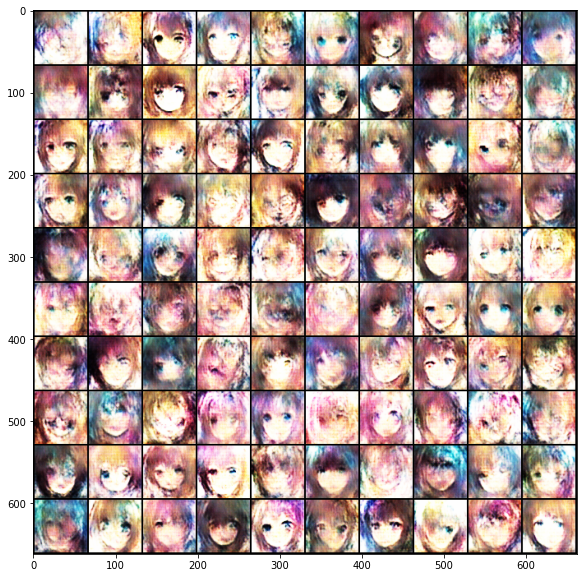

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:47<00:00:00  3.21it/s  -0.8754  0.5441   11    12265          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_011.jpg.


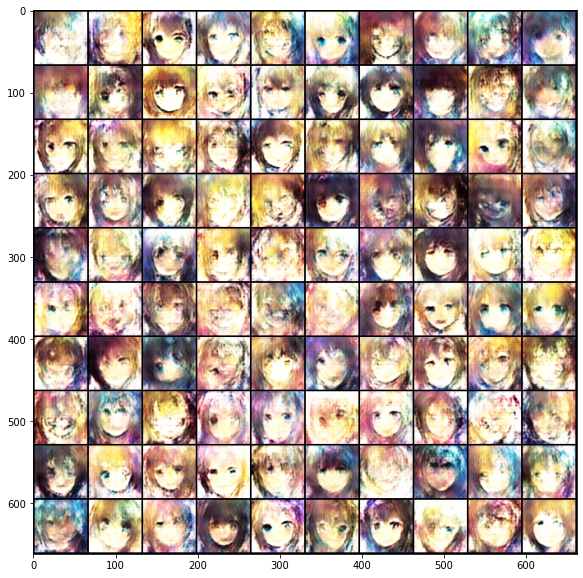

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step            
 1115/1115  00:05:46<00:00:00  3.22it/s  -1.49   0.7503   12    13380           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_012.jpg.


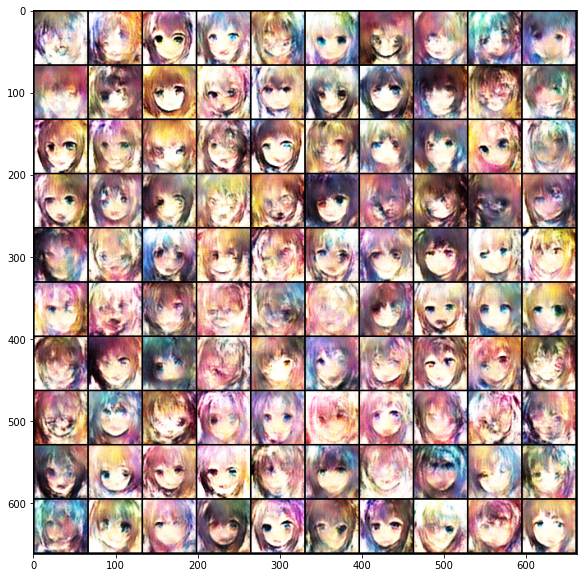

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4573  0.7384   13    14495          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_013.jpg.


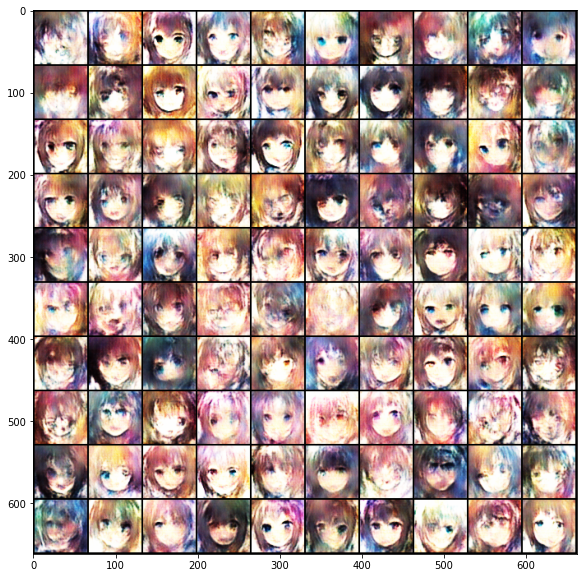

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4518  0.7437   14    15610          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_014.jpg.


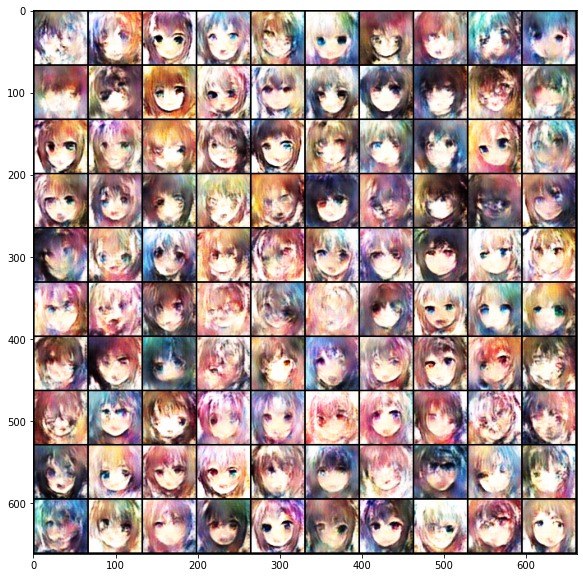

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:43<00:00:00  3.24it/s  -1.4372  0.7361   15    16725          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_015.jpg.


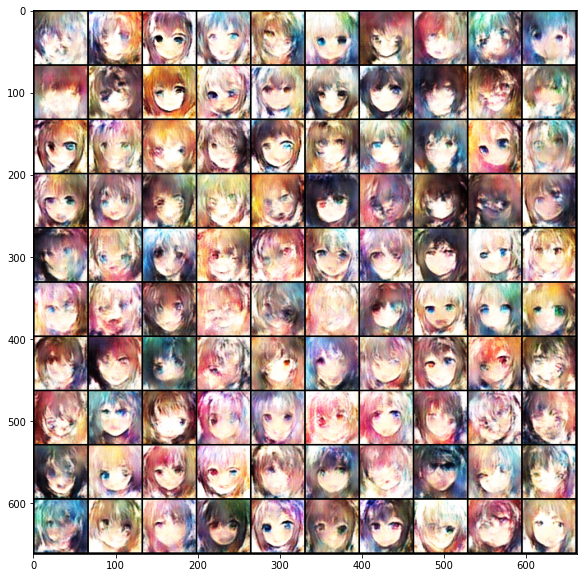

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step            
 1115/1115  00:05:46<00:00:00  3.22it/s  -1.493  0.742    16    17840           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_016.jpg.


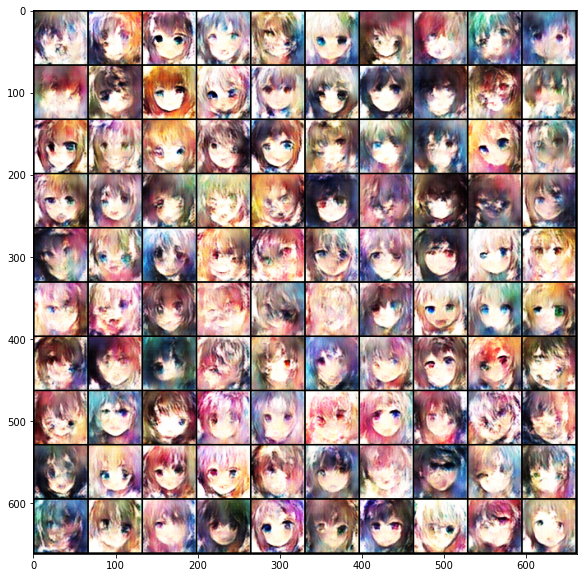

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.22it/s  -0.4417  0.6522   17    18955          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_017.jpg.


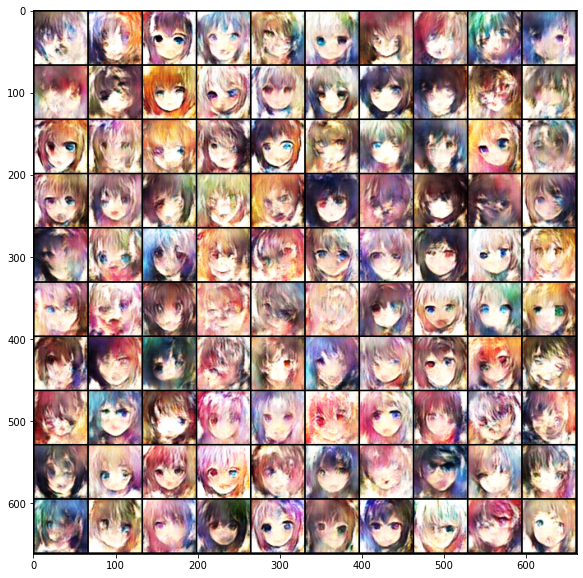

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:46<00:00:00  3.22it/s  -1.2481  0.3709   18    20070          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_018.jpg.


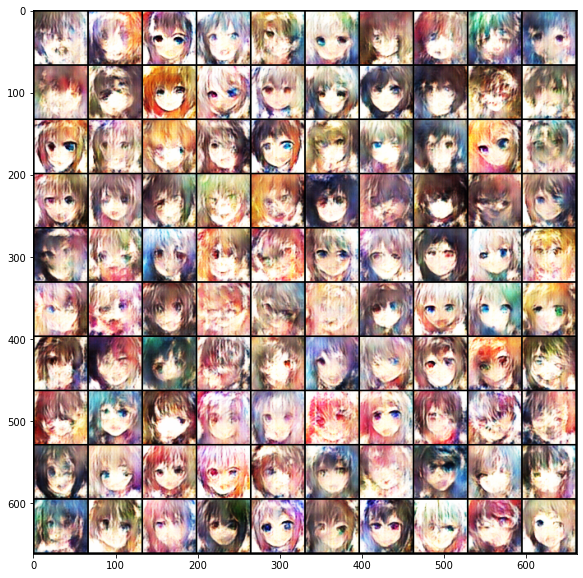

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:46<00:00:00  3.22it/s  -1.0516  0.6933   19    21185          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_019.jpg.


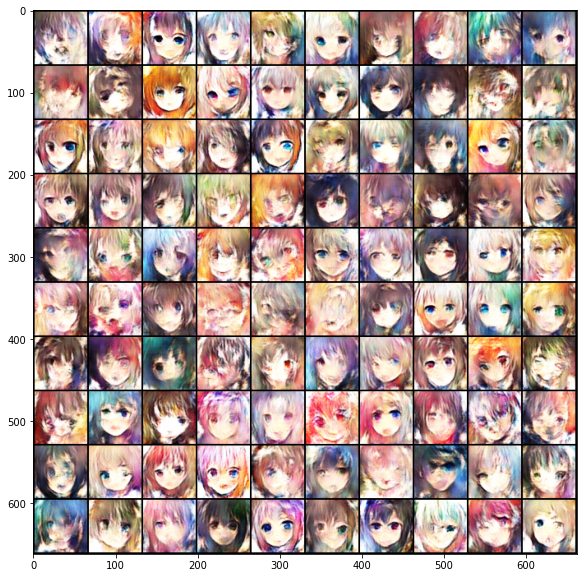

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4625  0.745    20    22300          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_020.jpg.


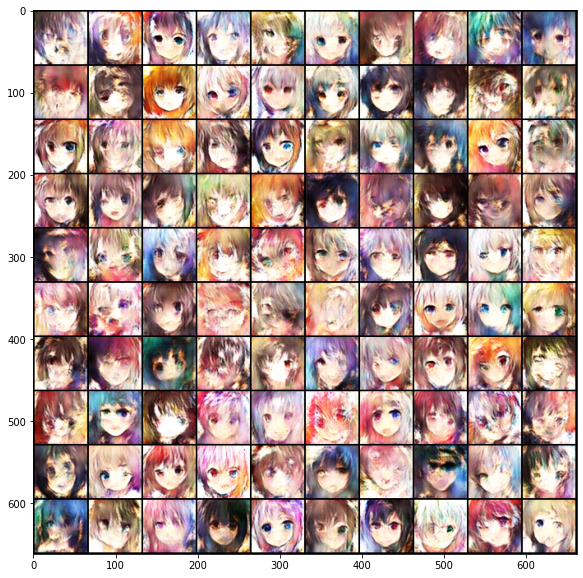

  Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step            
 365/1115  00:01:53<00:03:52  3.22it/s  -1.4182  0.7327   21    22665           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:44<00:00:00  3.24it/s  -1.0726  0.7236   21    23415          

| save some samples to ./logs/Epoch_021.jpg.


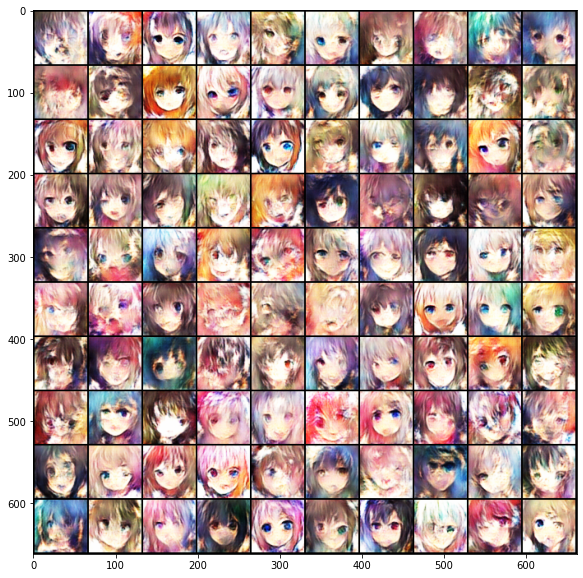

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:44<00:00:00  3.24it/s  -1.1677  0.7169   22    24530          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_022.jpg.


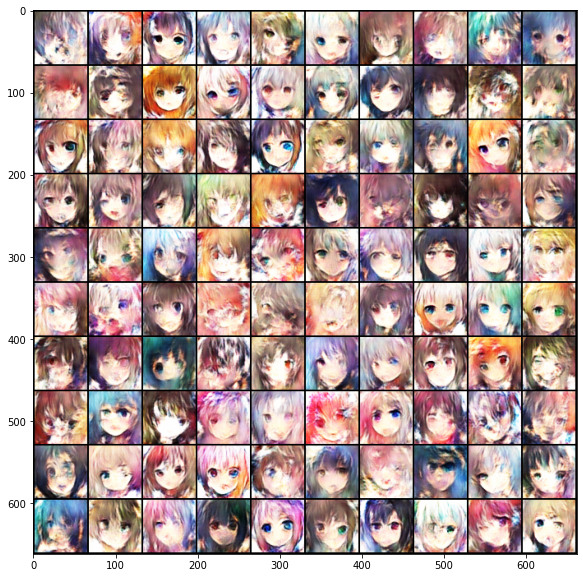

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.4088  0.7089   23    25645          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_023.jpg.


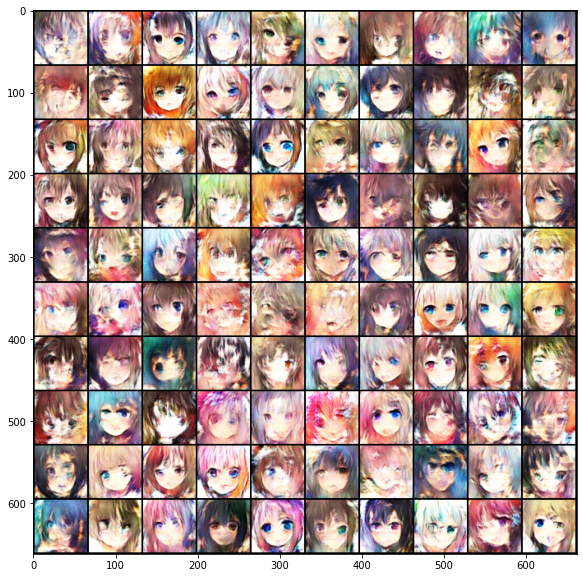

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step            
 1115/1115  00:05:45<00:00:00  3.22it/s  -1.375  0.7094   24    26760           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_024.jpg.


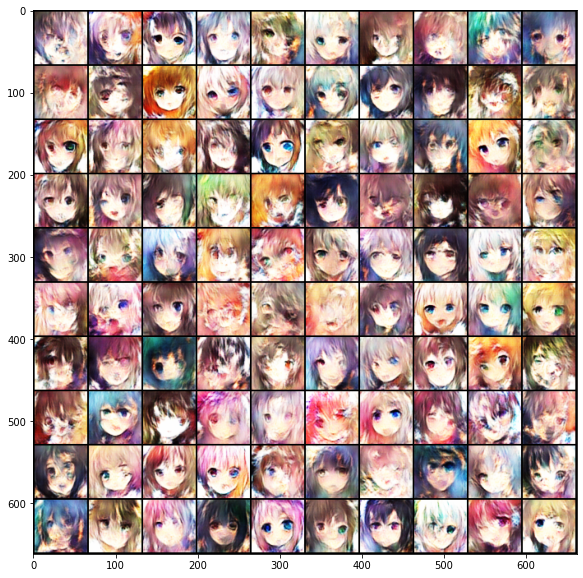

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.3696  0.6902   25    27875          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_025.jpg.


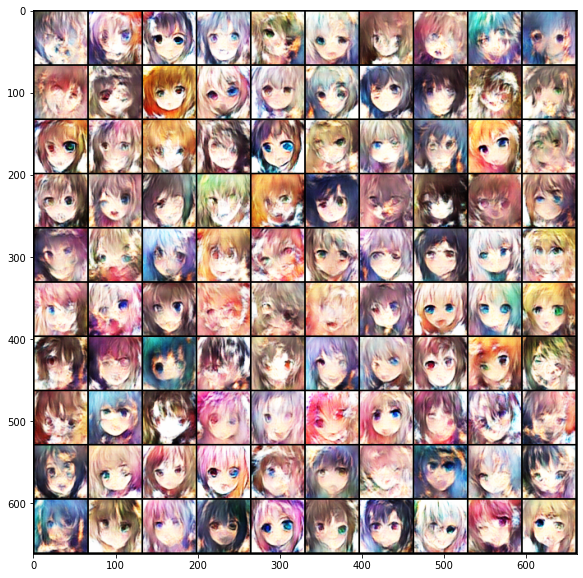

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:46<00:00:00  3.22it/s  -0.8258  0.5407   26    28990          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_026.jpg.


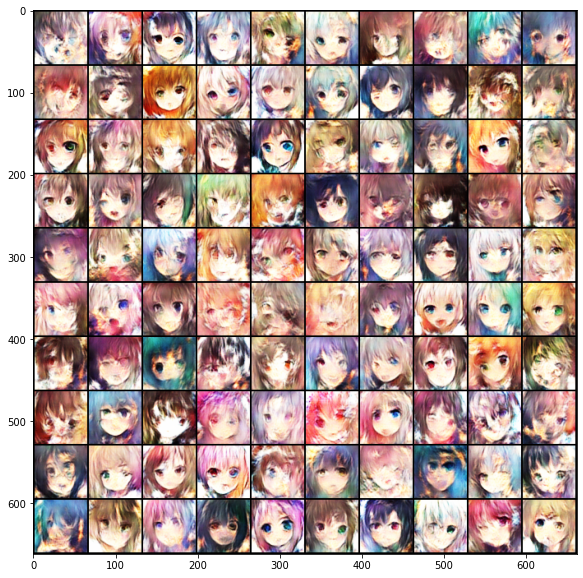

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:46<00:00:00  3.21it/s  -1.1656  0.4253   27    30105          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_027.jpg.


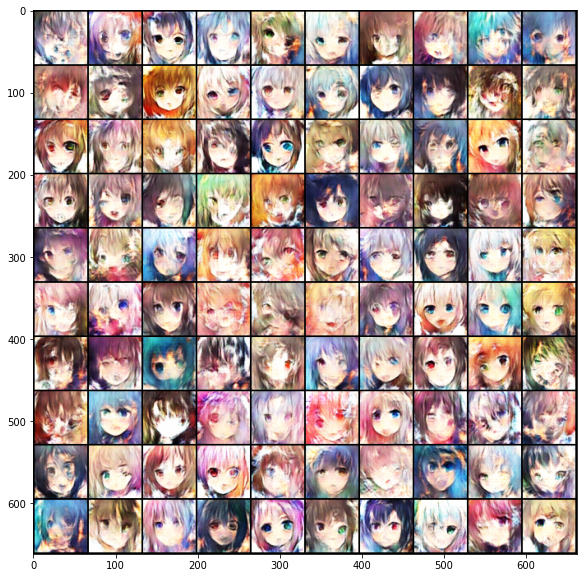

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:47<00:00:00  3.21it/s  -1.3494  0.7011   28    31220          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_028.jpg.


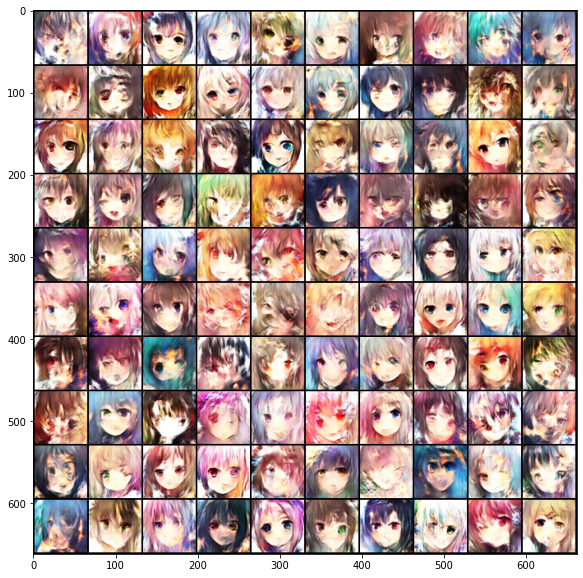

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.22it/s  -1.3486  0.6631   29    32335          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_029.jpg.


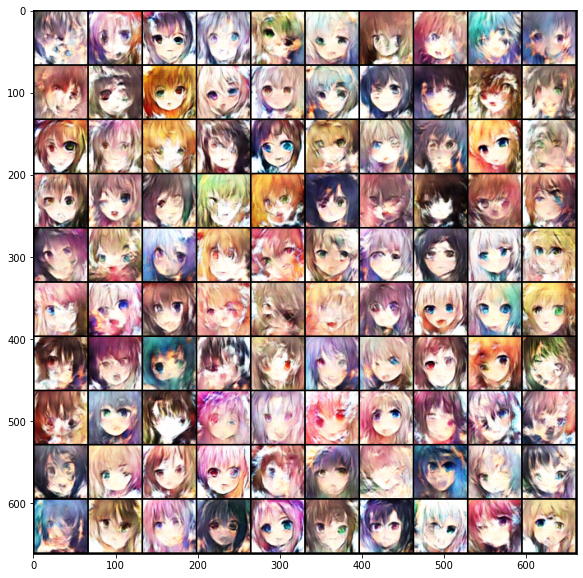

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.3712  0.7068   30    33450          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_030.jpg.


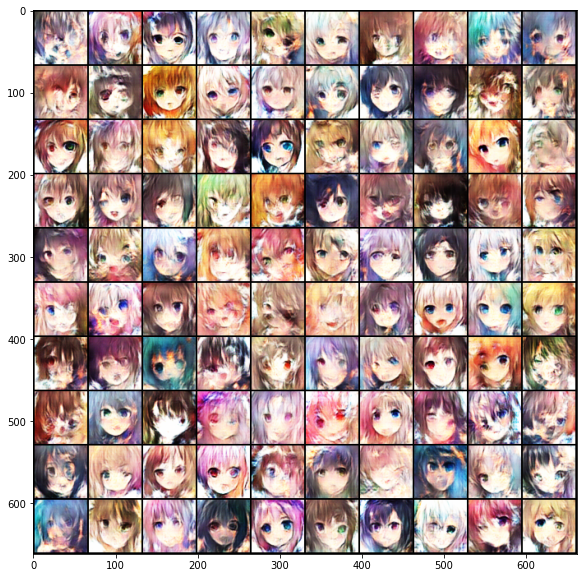

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step           
 1115/1115  00:05:45<00:00:00  3.23it/s  -1.2976  0.7152   31    34565          

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

| save some samples to ./logs/Epoch_031.jpg.


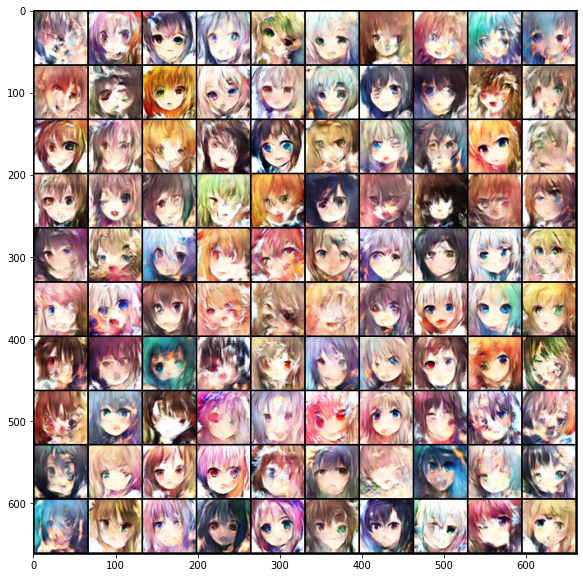

  Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step            
 993/1115  00:05:07<00:00:37  3.23it/s  -1.3327  0.709    32    35558           

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

In [ ]:
steps = 0
for e, epoch in enumerate(range(n_epoch)):
  progress_bar = qqdm(dataloader)
  for i, data in enumerate(progress_bar):
    imgs = data
    imgs = imgs.cuda()
    bs = imgs.size(0)

    # ====================
    # Train D
    # ====================
    z = Variable(torch.randn(bs, z_dim)).cuda()
    r_imgs = Variable(imgs).cuda()
    f_imgs = G(z)

    # WGAN loss
    loss_D = -torch.mean(D(r_imgs)) + torch.mean(D(f_imgs))

    D.zero_grad()
    loss_D.backward()
    opt_D.step()

    # clip weight of discriminator
    for p in D.parameters():
      p.data.clamp_(-clip_value, clip_value)

    # ====================
    # Train G
    # ====================
    if steps % n_critic == 0:
      # Generate some fake images
      z = Variable(torch.randn(bs, z_dim)).cuda()
      f_imgs = G(z)

      f_logit = D(f_imgs)

      loss_G = -torch.mean(D(f_imgs))

      G.zero_grad()
      loss_G.backward()
      opt_G.step()

    steps += 1

    # Set the info of the progress bar
    #   Note that the value of the GAN loss is not directly related to
    #   the quality of the generated images.
    progress_bar.set_infos({
        'Loss_D': round(loss_D.item(), 4),
        'Loss_G': round(loss_G.item(), 4),
        'Epoch': e+1,
        'Step': steps,
    })

  G.eval()
  f_imgs_sample = (G(z_sample).data + 1) / 2.0
  filename = os.path.join(log_dir, f'Epoch_{epoch + 1:03d}.jpg')
  torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
  print(f'| save some samples to {filename}.')

  # Show generated images in the jupyter notebook.
  grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
  plt.figure(figsize=(10,10))
  plt.imshow(grid_img.permute(1, 2, 0))
  plt.show()
  G.train()

  if (e+1) % 5 == 0 or e == 0:
    # Save the checkpoints.
    torch.save(G.state_dict(), os.path.join(ckpt_dir, 'G.pth'))
    torch.save(D.state_dict(), os.path.join(ckpt_dir, 'D.pth'))

## Inference
Use the trained model to generate anime faces.

In [ ]:
G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join(ckpt_dir, 'G.pth')))
G.eval()
G.cuda()

In [ ]:
# Generate 1000 images and make a grid to save them.
n_output = 1000
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
log_dir = os.path.join(workspace_dir, 'logs')
filename = os.path.join(log_dir, 'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)

# Show 32 of the images.
grid_img = torchvision.utils.make_grid(imgs_sample[:32].cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()